### Todo

- INIT MODEL WITH CLASSIFIER MODEL WEIGHTS ✅ - no help
- FINE TUNE ✅ - no help
- ADD MORE AUGMENTATION (ZOOM, CROP ON DIFF BACK) ✅ - helped
- PREDICT WITH TTA ✅ - helped
- DISABLE BATCHNORM, BATCH-RENORM, INPLACE ABN ✅ - no help

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import sys
import shutil
import os
from pathlib import Path
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split

In [2]:
sys.path.append("../fastai/old")
from fastai.conv_learner import *

### Train a detection/segmentation model for images with ships

**idea : rather than fine tuning imagenet for detection/segmentation fine tune with the fine tuned model for ship classifier** 

- train_seg_lbs : images in train_all folder with segmentation
- test_seg_lbs : images in test_all folder with segmentation

In [3]:
path = Path("../DATA/airbus-ship/")
files = list(path.iterdir())

In [4]:
files

[PosixPath('../DATA/airbus-ship/clean_has_ship_test.txt'),
 PosixPath('../DATA/airbus-ship/train'),
 PosixPath('../DATA/airbus-ship/train_ship_segmentations.csv'),
 PosixPath('../DATA/airbus-ship/segmentation'),
 PosixPath('../DATA/airbus-ship/submission'),
 PosixPath('../DATA/airbus-ship/team_data'),
 PosixPath('../DATA/airbus-ship/test_v2'),
 PosixPath('../DATA/airbus-ship/tmp'),
 PosixPath('../DATA/airbus-ship/detection'),
 PosixPath('../DATA/airbus-ship/test_ship_segmentations.csv'),
 PosixPath('../DATA/airbus-ship/test_detection'),
 PosixPath('../DATA/airbus-ship/models'),
 PosixPath('../DATA/airbus-ship/classification'),
 PosixPath('../DATA/airbus-ship/clean_delete_train.txt'),
 PosixPath('../DATA/airbus-ship/clean_has_ship_train.txt'),
 PosixPath('../DATA/airbus-ship/test')]

### Recover segmentation data

In [5]:
train_images = ! ls {path}/"train"
test_images = ! ls {path}/"test"

In [17]:
train_segmentation = pd.read_csv(path/"train_ship_segmentations.csv")
test_segmentation = pd.read_csv(path/"test_ship_segmentations.csv")

In [24]:
all_segmentation = pd.concat([train_segmentation, test_segmentation])

In [26]:
trn_segmentation_df = all_segmentation[all_segmentation.ImageId.isin(train_images)]
test_segmentation_df = all_segmentation[all_segmentation.ImageId.isin(test_images)]

In [28]:
trn_segmentation_df.shape, test_segmentation_df.shape

((207548, 2), (24175, 2))

In [31]:
# remove images without ship
trn_segmentation_df = trn_segmentation_df[~trn_segmentation_df.EncodedPixels.isna()]
test_segmentation_df = test_segmentation_df[~test_segmentation_df.EncodedPixels.isna()]

In [32]:
os.makedirs(path/"segmentation", exist_ok=True)

In [33]:
trn_segmentation_df.reset_index(drop=True).to_csv(path/"segmentation/trn_segmentation.csv", index=False)
test_segmentation_df.reset_index(drop=True).to_csv(path/"segmentation/test_segmentation.csv", index=False)

### Visualize segmentation data

We exclude images without ship to deal with imbalance and focus on learning ship segmentation...

In [5]:
train_seg_lbs = pd.read_csv(path/"segmentation/trn_segmentation.csv")
test_seg_lbs = pd.read_csv(path/"segmentation/test_segmentation.csv")

In [6]:
print(f"# of train segmentation images: {train_seg_lbs.ImageId.nunique()}")
print(f"# of test segmentation images: {test_seg_lbs.ImageId.nunique()}")

# of train segmentation images: 38174
# of test segmentation images: 4382


In [7]:
print(f"# of train segmentation labels/ships: {len(train_seg_lbs.ImageId)}")
print(f"# of test segmentation labels/ships: {len(test_seg_lbs)}")

# of train segmentation labels/ships: 73166
# of test segmentation labels/ships: 8557


In [8]:
from rle import rle_decode, rle_encode
from seg_plots import show_img_masks, plot_segmentation_df

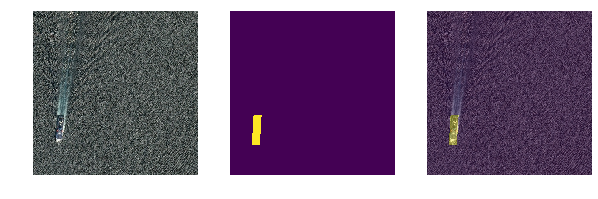

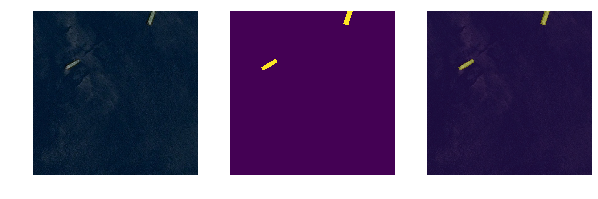

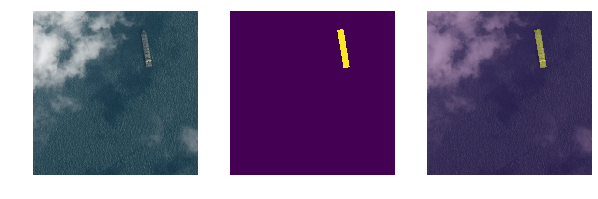

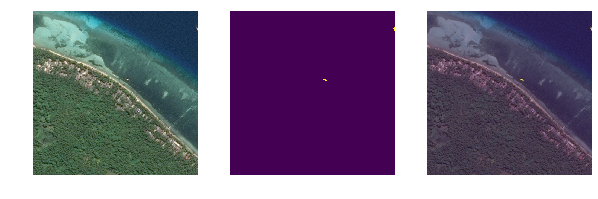

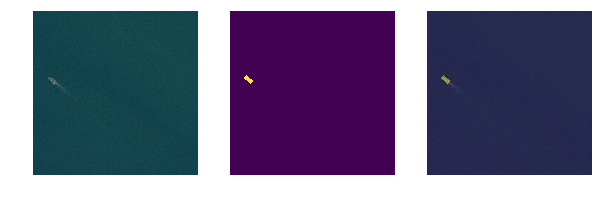

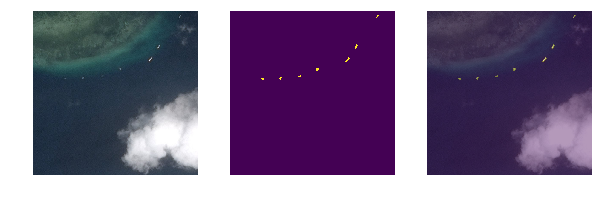

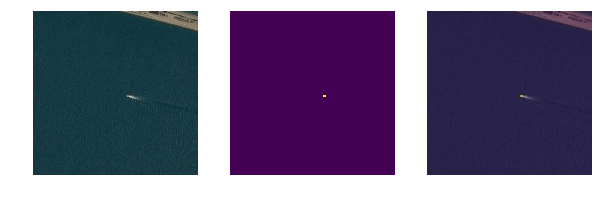

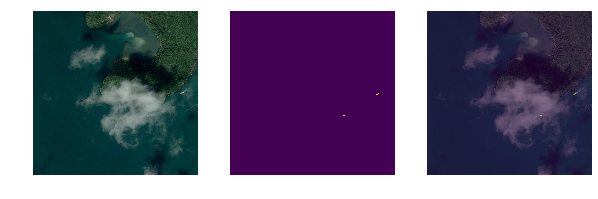

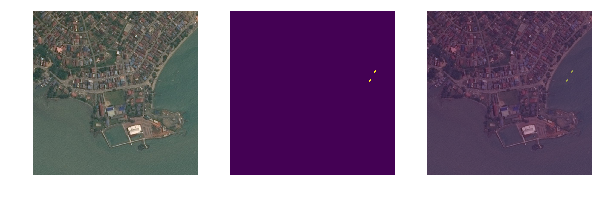

In [9]:
plot_segmentation_df(train_seg_lbs, path/'train', n=10, size=(10, 10))

### Save all masks 

Having rle_decode inside get_y is very expensive

In [68]:
from tqdm import tqdm
from concurrent.futures import as_completed
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor

def run_multi_progess(function, args_list, is_thread=True, **kwargs):
    # kwargs = {'unit': 'files','unit_scale': True, 'leave': True}
    if is_thread: executor = ThreadPoolExecutor(8)
    else: executor = ProcessPoolExecutor(4)
    with executor as e:
        futures = [e.submit(function, arg) for arg in args_list]
        for f in tqdm(as_completed(futures), total=len(futures), **kwargs):
            pass

In [69]:
trn_unique_img_ids = train_seg_lbs.ImageId.unique()
test_unique_img_ids = test_seg_lbs.ImageId.unique()

In [70]:
os.makedirs(path/'segmentation/train_masks', exist_ok=True)
os.makedirs(path/'segmentation/test_masks', exist_ok=True)

In [78]:
trn_unique_img_ids[:4]

array(['000155de5.jpg', '00021ddc3.jpg', '0002756f7.jpg', '00053c6ba.jpg'], dtype=object)

In [86]:
def save_train_mask(img_id):
    rles = train_seg_lbs[train_seg_lbs.ImageId == img_id]['EncodedPixels'].values
    masks = sum([rle_decode(rle, (768, 768)) for rle in rles])
    np.save(str(path/'segmentation/train_masks'/img_id), masks)

In [87]:
def save_test_mask(img_id):
    rles = test_seg_lbs[test_seg_lbs.ImageId == img_id]['EncodedPixels'].values
    masks = sum([rle_decode(rle, (768, 768)) for rle in rles])
    np.save(str(path/'segmentation/test_masks'/img_id), masks)

In [88]:
run_multi_progess(save_train_mask, trn_unique_img_ids, unit=' images')

100%|██████████| 38174/38174 [08:09<00:00, 77.99 images/s] 


In [89]:
run_multi_progess(save_test_mask, test_unique_img_ids, unit=' images')

100%|██████████| 4382/4382 [00:14<00:00, 302.45 images/s]


### Dynamic unet segmentation Model

In [5]:
from fastai.models.unet import *
from fastai.dataset import *
from fastai.core import *

In [6]:
train_seg_lbs = pd.read_csv(path/"segmentation/trn_segmentation.csv")
test_seg_lbs = pd.read_csv(path/"segmentation/test_segmentation.csv")

In [7]:
unique_img_ids = train_seg_lbs.ImageId.unique()
trn_fnames, val_fnames = train_test_split(unique_img_ids, test_size=0.1, random_state=42)

In [8]:
test_fnames = test_seg_lbs.ImageId.unique()

In [9]:
TRN_X = [f"train/{fname}" for fname in trn_fnames]
TRN_Y = [f"segmentation/train_masks/{fname}.npy" for fname in trn_fnames]

VAL_X = [f"train/{fname}" for fname in val_fnames]
VAL_Y = [f"segmentation/train_masks/{fname}.npy" for fname in val_fnames]

TEST_X = [f"test/{fname}" for fname in test_fnames]
TEST_Y = [f"segmentation/test_masks/{fname}.npy" for fname in test_fnames]

In [10]:
test_sub_fnames = list((path/"test_v2").glob("*.jpg"))
TEST_SUB_X = [f"test_v2/{fname.name}" for fname in test_sub_fnames]

In [11]:
TEST_SUB_X[:3]

['test_v2/c7b10873e.jpg', 'test_v2/563b384e1.jpg', 'test_v2/b51dde87a.jpg']

In [12]:
len(TRN_X), len(VAL_X), len(TEST_X), len(TEST_SUB_X)

(34356, 3818, 4382, 15606)

In [13]:
TRN_Y[:4]

['segmentation/train_masks/647be9508.jpg.npy',
 'segmentation/train_masks/39d765172.jpg.npy',
 'segmentation/train_masks/8977bc0a0.jpg.npy',
 'segmentation/train_masks/21f38f0b1.jpg.npy']

In [14]:
TEST_Y[:4]

['segmentation/test_masks/00031f145.jpg.npy',
 'segmentation/test_masks/002c62c03.jpg.npy',
 'segmentation/test_masks/004f97cfb.jpg.npy',
 'segmentation/test_masks/005a7670a.jpg.npy']

In [15]:
np.load(path/TEST_Y[0])

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

### Check masks

- Some masks are not separated

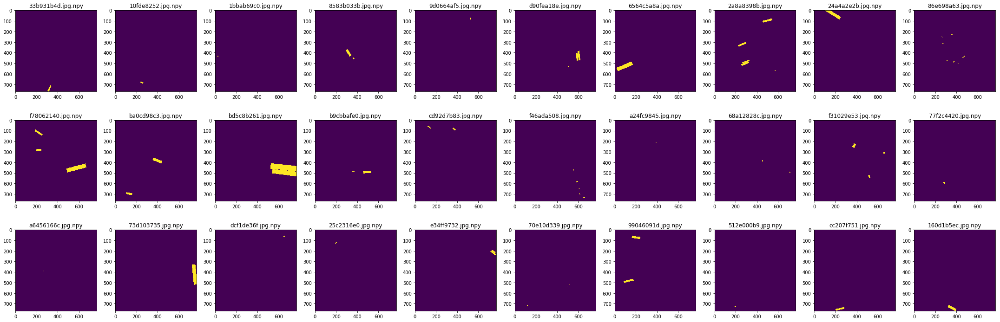

In [38]:
nrows = 3
fig, axes = plt.subplots(nrows, 10, figsize=(nrows*10, 10))
for i, ax in enumerate(axes.flatten()): 
    fname = np.random.permutation(VAL_Y)[i]
    ax.imshow(np.load(path/fname))
    ax.set_title(fname.split("/")[-1])
    
fig.tight_layout()

In [16]:
class FilesEncodedDataset(BaseDataset):
    def __init__(self, fnames, fnames2, transform, path):
        self.fnames = fnames
        self.fnames2 = fnames2
        self.path = path
        super().__init__(transform)
    
    def get_sz(self): return self.transform.sz
    def get_x(self, i): return open_image(os.path.join(self.path, self.fnames[i]))
    def get_y(self, i): 
        mask = np.load(os.path.join(self.path, self.fnames2[i])).astype('float32')
        return mask
        
    def get_n(self): return len(self.fnames)
    def get_c(self): return 0

    def resize_imgs(self, targ, new_path):
        dest = resize_imgs(self.fnames, targ, self.path, new_path)
        return self.__class__(self.fnames, self.y, self.transform, dest)

    def denorm(self,arr):
        """Reverse the normalization done to a batch of images.

        Arguments:
            arr: of shape/size (N,3,sz,sz)
        """
        if type(arr) is not np.ndarray: arr = to_np(arr)
        if len(arr.shape)==3: arr = arr[None]
        return self.transform.denorm(np.rollaxis(arr,1,4))

In [17]:
class Transform():
    """ A class that represents a transform.

    All other transforms should subclass it.
    All subclasses should override
    do_transform.

    Arguments
    ---------
        tfm_y : TfmType
            type of transform
    """
    def __init__(self, tfm_y=TfmType.NO):
        self.tfm_y=tfm_y
        self.store = threading.local()

    def set_state(self): pass
    def __call__(self, x, y):
        self.set_state()
        x,y = ((self.transform(x),y) if self.tfm_y==TfmType.NO
                else self.transform(x,y) if self.tfm_y in (TfmType.PIXEL, TfmType.CLASS)
                else self.transform_coord(x,y))
        return x, y

    def transform_coord(self, x, y): return self.transform(x),y

    def transform(self, x, y=None):
        x = self.do_transform(x,False)
        return (x, self.do_transform(y,True)) if y is not None else x

    @abstractmethod
    def do_transform(self, x, is_y): raise NotImplementedError

In [18]:
class RandomLighting(Transform):
    def __init__(self, b, c, tfm_y=TfmType.NO):
        super().__init__(tfm_y)
        self.b,self.c = b,c

    def set_state(self):
        self.store.b_rand = rand0(self.b)
        self.store.c_rand = rand0(self.c)

    def do_transform(self, x, is_y):
        if is_y and self.tfm_y != TfmType.PIXEL: return x
        b = self.store.b_rand
        c = self.store.c_rand
        c = -1/(c-1) if c<0 else c+1
        x = lighting(x, b, c)
        return x

In [19]:
class RandomDihedral(CoordTransform):
    """
    Rotates images by random multiples of 90 degrees and/or reflection.
    Please reference D8(dihedral group of order eight), the group of all symmetries of the square.
    """
    def set_state(self):
        self.store.rot_times = random.randint(0,3)
        self.store.do_flip = random.random()<0.5

    def do_transform(self, x, is_y):
        x = np.rot90(x, self.store.rot_times)
        return np.fliplr(x).copy() if self.store.do_flip else x

### Test Augmentations

In [30]:
#RandomRotate(deg=30, p=0.7, tfm_y=TfmType.PIXEL)
f = resnet18
sz = 768
tfms = tfms_from_model(f,
                       sz,
                       aug_tfms=[RandomDihedral(tfm_y=TfmType.PIXEL),
                                 RandomBlur(),
                                 RandomLighting(0.05, 0.05)],
                       tfm_y=TfmType.PIXEL,
                       norm_y=False,
                       crop_type=CropType.NO) 

In [31]:
dataset = ImageData.get_ds(FilesEncodedDataset, 
                           trn=(TRN_X, TRN_Y),
                           val=(VAL_X, VAL_Y), tfms=tfms,
                           test=(TEST_X, TEST_Y) ,path=path)

In [32]:
md = ImageData(path, dataset, bs=4, num_workers=8, classes=None)

In [24]:
denorm = md.trn_ds.denorm

In [ ]:
*x, y= next(iter(md.trn_dl))

In [ ]:
# plot augmentations
i = 0

fig_sz = (20, 20)
fig, axes = plt.subplots(2, 4, figsize=fig_sz)
for ax in np.rollaxis(axes, -1):
    x,y = next(iter(md.aug_dl))
    img = denorm(x)[i]
    ax[0].imshow(img)
    ax[1].imshow(to_np(y[i]))

In [25]:
np.unique(to_np(y[0]))

array([0., 1.], dtype=float32)

In [24]:
print(f"n train: {len(md.trn_ds)}, n val: {len(md.val_ds)}, n test: {len(md.test_ds)}")

n train: 34356, n val: 3818, n test: 4382


### Model

In [20]:
# load defined model# load  
def get_encoder(f, cut):
    base_model = (cut_model(f(True), cut))
    return nn.Sequential(*base_model)

def get_model(f=resnet18, sz=128):
    """gets dynamic unet model"""
    # cut encoder
    cut, cut_lr = model_meta[f]

    # define encoder
    encoder = get_encoder(f, cut)

    # init model
    # binary: ship - not ship
    m = DynamicUnet(encoder, n_classes=1) 

    # init upsample on cpu
    inp = torch.ones(1, 3, sz, sz)
    out = m(V(inp).cpu())

    # put model to gpu if desired# put mo 
    m = m.cuda(0)
    return m

In [21]:
def dice_loss(logits, target):
    logits = torch.sigmoid(logits)
    smooth = 1.0

    iflat = logits.view(-1)
    tflat = target.view(-1)
    intersection = (iflat * tflat).sum()
    
    return ((2.0 * intersection + smooth) / (iflat.sum() + tflat.sum() + smooth))

In [28]:
class FocalLoss(nn.Module):
    def __init__(self, gamma):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, logits, target):
        logits = logits.squeeze(1)
        probas = torch.sigmoid(logits)
        pt = (targets)*probas + (1 - targets)*(1 - probas)
        loss = (-(1 - pt)**gamma)*torch.log(pt)
        return loss.mean()

In [23]:
class FocalLoss(nn.Module):
    def __init__(self, gamma):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, logits, target):
        logits = logits.squeeze(1)
        if not (target.size() == logits.size()):
            raise ValueError("Target size ({}) must be the same as input size ({})"
                             .format(target.size(), logits.size()))

        max_val = (-logits).clamp(min=0)
        loss = logits - logits * target + max_val + \
            ((-max_val).exp() + (-logits - max_val).exp()).log()

        invprobs = F.logsigmoid(-logits * (target * 2.0 - 1.0))
        loss = (invprobs * self.gamma).exp() * loss
        
        return loss.mean()

In [24]:
class BCELoss2D(nn.Module):
    def __init__(self):
        super(BCELoss2D, self).__init__()
        
    def forward(self, logits, targets):
        logits = logits.squeeze(1)
        logits = F.sigmoid(logits)
        return F.binary_cross_entropy(logits, targets)

In [25]:
class MixedLoss(nn.Module):
    def __init__(self, alpha, gamma):
        super().__init__()
        self.alpha = alpha
        self.focal = FocalLoss(gamma)
        
    def forward(self, input, target):
        loss = self.alpha*self.focal(input, target) - torch.log(dice_loss(input, target))
        return loss.mean()

In [26]:
class UpsampleModel():
    def __init__(self, model, cut_lr, name='upsample'):
        self.model,self.name, self.cut_lr = model, name, cut_lr

    def get_layer_groups(self, precompute):
        lgs = list(split_by_idxs(children(self.model.encoder), [self.cut_lr]))
        return lgs + [children(self.model)[1:]]

### Test metric

ref: https://www.kaggle.com/stkbailey/step-by-step-explanation-of-scoring-metric

In [27]:
from skimage.measure import label
from eval_metric import sigmoid, get_gt_masks, create_iou_matrix, f2_IOU, get_pred_masks

In [28]:
def single_image_score(labels, gt_rles, gt):
    """
    return avg thresholded f2 score for single image
    labels : labeled image array
    gt_rles : array of rles
    """
    if len(np.unique(labels)) == 1:
        if gt is None: 
            """original image has no instance"""
            return 1
        else:
            """no prediction is made tp = 0"""
            return 0
    else:
        pred_mask_arrays = get_pred_masks(labels)
        gt_mask_arrays = get_gt_masks(gt_rles)
        IOU = create_iou_matrix(pred_mask_arrays, gt_mask_arrays)
        return f2_IOU(IOU)

In [33]:
shift = 0 # shift to keep track of file index 
n_valids = len(md.val_ds) # total # of validation samples
fnames = md.val_ds.fnames # validation filenames
df = train_seg_lbs

def fastai_metric(preds, targs):
    global shift
    global df
    global fnames
    global n_valids
    
    mask_thresh = 0.5 
    n_x = len(preds)

    scores = [] 
    preds = (sigmoid(to_np(preds).squeeze(1)) > mask_thresh).astype('uint8')
    gts = to_np(targs)
    
    for i, (gt_i, pred_i) in enumerate(zip(gts, preds)):
        fname = fnames[i+shift]
        gt_rles = df[df.ImageId == fname.split("/")[-1]]['EncodedPixels'].values
        labels = label(pred_i)
        scores.append(single_image_score(labels, gt_rles, gt_i))

    shift += n_x
    if shift == n_valids: shift = 0
    return np.mean(scores)

### Train with eval metric

In [34]:
init_model = False
f = resnet18
cut, cut_lr = model_meta[f]
model = get_model(f, sz=768)
models = UpsampleModel(model, cut_lr)

learn = ConvLearner(md, models)
learn.opt_fn=optim.Adam
learn.crit = MixedLoss(10, 2)
learn.metrics = [fastai_metric]

In [79]:
learn.lr_find()

 66%|██████▌   | 5680/8589 [28:08<08:27,  5.73it/s, loss=1.89]   

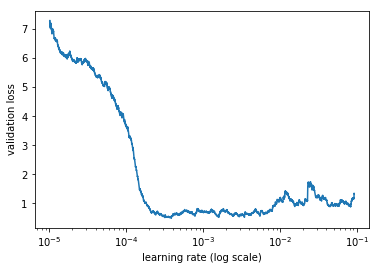

In [80]:
learn.sched.plot()

In [ ]:
learn.fit(3e-4, n_cycle=10, cycle_len=10, use_clr=(20, 10))

### Fine tuning

In [ ]:
learn.unfreeze()
lr = 1e-3
lrs = [lr/100, lr/10, lr]
learn.fit(lrs, n_cycle=1, cycle_len=8)

### Visualize predictions

In [35]:
learn.load("team_resnet18_fold_1")

In [36]:
from seg_plots import plot_batch

/home/ubuntu/anaconda3/envs/fastai/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


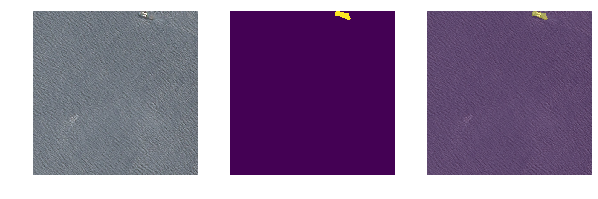

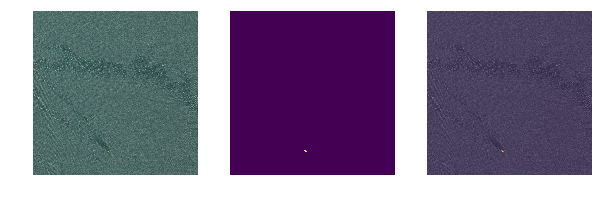

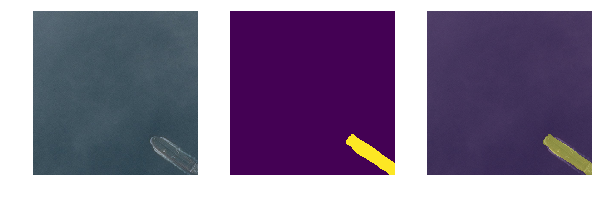

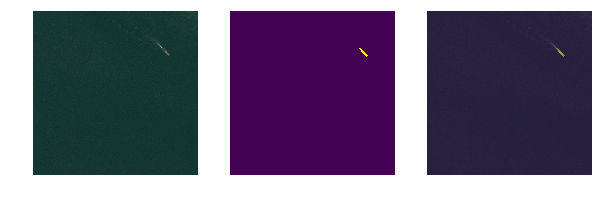

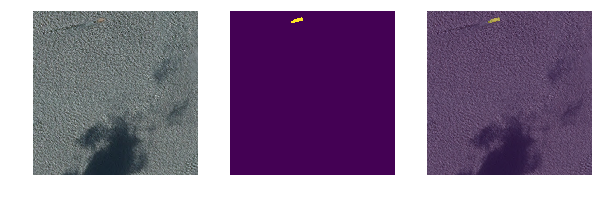

...

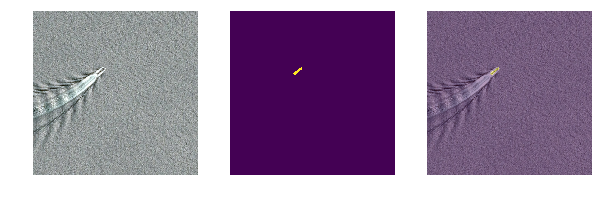

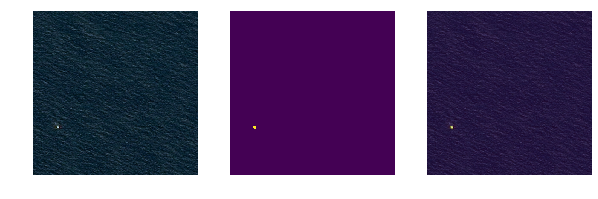

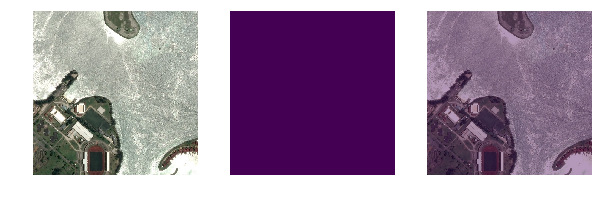

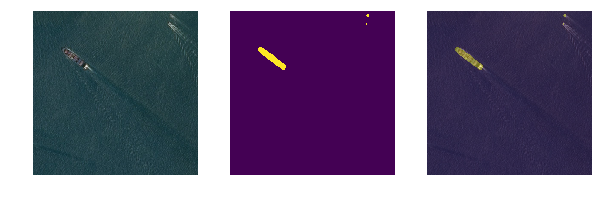

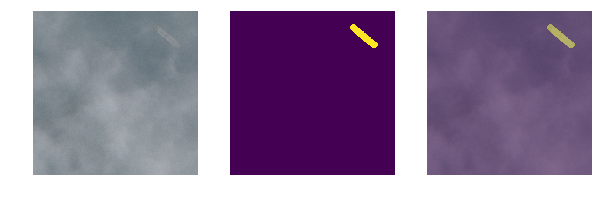

In [37]:
plot_batch(path,
           learn.model.eval(),
           learn.data.val_dl,
           learn.data.val_ds.fnames,
           20)

### Evaluate Holdout Test Preds

In [38]:
from seg_plots import show_img_masks

#### Flip TTAs

In [39]:
def flip(x, dim):
    dim = x.dim() + dim if dim < 0 else dim
    inds = tuple(slice(None, None) if i != dim
             else x.new(torch.arange(x.size(i)-1, -1, -1).tolist()).long()
             for i in range(x.dim()))
    return x[inds]

In [44]:
def tta_preds(x, model, mode="max"):
    out1 = to_np(model(V(x))) # original
    out2 = to_np(model(V(torch.transpose(x,2,3).contiguous()))) # transpose
    out3 = to_np(model(V(flip(x, 2)))) # flip dim=2 - y axis - updown
    out4 = to_np(model(V(flip(x, 3)))) # flip dim=3 - x axis - left right
    out5 = to_np(model(V(flip(flip(x, 2), 3)))) # flip dim=3 - x axis - updown left right
    out6 = to_np(model(V(flip(torch.transpose(x,2,3).contiguous(), 3)))) # transpose left right
    out7 = to_np(model(V(flip(torch.transpose(x,2,3).contiguous(), 2)))) # transpose up down
    
    
    out1_probas = sigmoid(out1).squeeze(1) # original
    out2_probas = sigmoid(out2).squeeze(1) # transpose
    out3_probas = sigmoid(out3).squeeze(1) # flip dim=2 - y axis - updown
    out4_probas = sigmoid(out4).squeeze(1) # flip dim=3 - x axis - left right
    out5_probas = sigmoid(out5).squeeze(1)
    out6_probas = sigmoid(out6).squeeze(1)
    out7_probas = sigmoid(out7).squeeze(1)
    
    # reverse it
    outs = []
    for i, (out1_i, out2_i, out3_i, out4_i, out5_i, out6_i, out7_i) in enumerate(zip(out1_probas, out2_probas,
                                                                      out3_probas, out4_probas,
                                                                      out5_probas, out6_probas,
                                                                      out7_probas)):
        

        
        if mode == "max":
            outs.append(np.max([out1_i,
                                out2_i.T,
                                np.flipud(out3_i),
                                np.fliplr(out4_i),
                                np.fliplr(np.flipud(out5_i)),
                                np.fliplr(out6_i).T,
                                np.flipud(out7_i).T
                               ], axis=0))
        elif mode == "mean":
            outs.append(np.mean([out1_i,
                                 out2_i.T,
                                 np.flipud(out3_i),
                                 np.fliplr(out4_i),
                                 np.fliplr(np.flipud(out5_i)),
                                 np.fliplr(out6_i).T,
                                 np.flipud(out7_i).T
                                ], axis=0))
        elif mode == "median":
            outs.append(np.median([out1_i,
                                 out2_i.T,
                                 np.flipud(out3_i),
                                 np.fliplr(out4_i),
                                 np.fliplr(np.flipud(out5_i)),
                                 np.fliplr(out6_i).T,
                                 np.flipud(out7_i).T
                                ], axis=0))
        
        
        elif mode is None:
            outs.append(out1_i)
    return outs

In [45]:
model = learn.model.eval()

In [46]:
denorm = md.val_ds.denorm

In [47]:
len(learn.data.test_dl), len(learn.data.test_ds)

(1096, 4382)

In [298]:
test_tta_preds = []
for i, (x,y) in enumerate(learn.data.test_dl):
    if i % 100 == 0: print(i)
    test_tta_preds += tta_preds(x, model, mode='median')

0
100
200
300
400
500
600
700
800
900
1000


In [299]:
test_tta_preds = np.array(test_tta_preds)

In [303]:
test_tta_preds.shape

(4382, 768, 768)

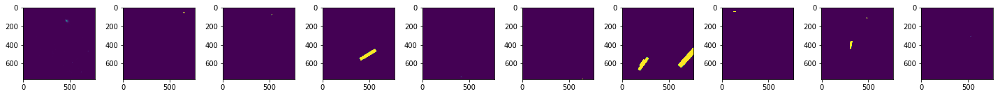

In [304]:
n = 10
fig, axes = plt.subplots(1, n, figsize=(20,30))
for ax,pred in zip(axes, test_tta_preds[:n]):
    ax.imshow(pred)
plt.tight_layout()

In [305]:
test_seg_lbs.head(2)

,ImageId,EncodedPixels
0,00031f145.jpg,340363 1 341129 4 341896 6 342663 7 343429 10 ...
1,002c62c03.jpg,490805 2 491570 5 492336 8 493104 8 493873 7 4...


In [306]:
test_preds = test_tta_preds

In [307]:
def mask2rectmask(mask):
    mask_copy = mask.copy()
    cnt_img, contours, hierarchy = cv2.findContours(mask_copy, 1, 2)
    cnt = contours[0]
    rect = cv2.minAreaRect(cnt)
    box = cv2.boxPoints(rect)
    box = np.int0(box)
    rect_mask = cv2.drawContours(mask_copy,[box],0,(255,255,255),-1)//255
    return rect_mask

In [308]:
def get_pred_masks(labels, sz=None, mask2rect=False, remove_sub_px=20):
    """
    labels: np.array with label indexes, e.g. output from label(X)
        Assuming all images are 768x768 originally,
    get independent instance mask predictions from a mask image output
    """
    uniq_labels = np.unique(labels)
    pred_mask_arrays = []
    for l in uniq_labels[1:]:
        label = (labels == l).astype(np.uint8)
        
        if remove_sub_px is not None:
            if np.sum(label) < remove_sub_px:
                continue
        
        if mask2rect and (len(uniq_labels) <= 2):
            label = mask2rectmask(label)
            
        if (sz is not None) and (label.shape[:2] != sz):
            pred_mask = cv2.resize(label, sz)
            pred_mask_arrays.append(pred_mask)
        else:
            pred_mask = label
            pred_mask_arrays.append(pred_mask)
    return pred_mask_arrays

In [309]:
def single_image_score(labels, gt_rles, gt):
    """
    return avg thresholded f2 score for single image
    labels : labeled image array
    gt_rles : array of rles
    """
    if len(np.unique(labels)) == 1:
        if gt is None: 
            """original image has no instance"""
            return 1
        else:
            """no prediction is made tp = 0"""
            return 0
    else:
        pred_mask_arrays = get_pred_masks(labels, mask2rect=False, remove_sub_px=20)
        gt_mask_arrays = get_gt_masks(gt_rles)
        IOU = create_iou_matrix(pred_mask_arrays, gt_mask_arrays)
        return f2_IOU(IOU)

In [310]:
pred_fnames = iter(zip(test_preds, learn.data.test_ds.fnames))

0


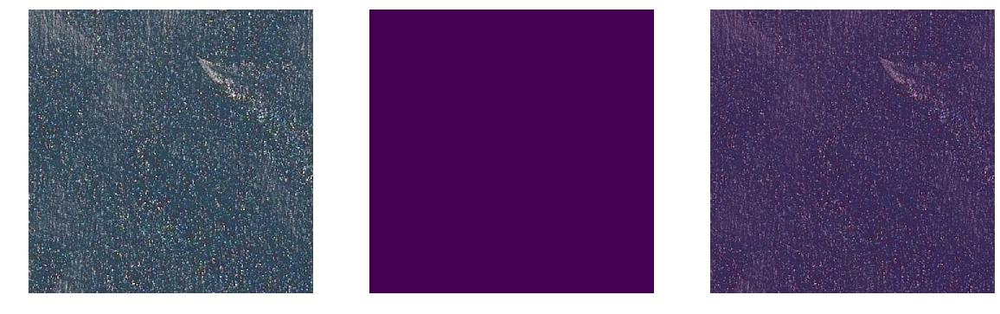

0.5


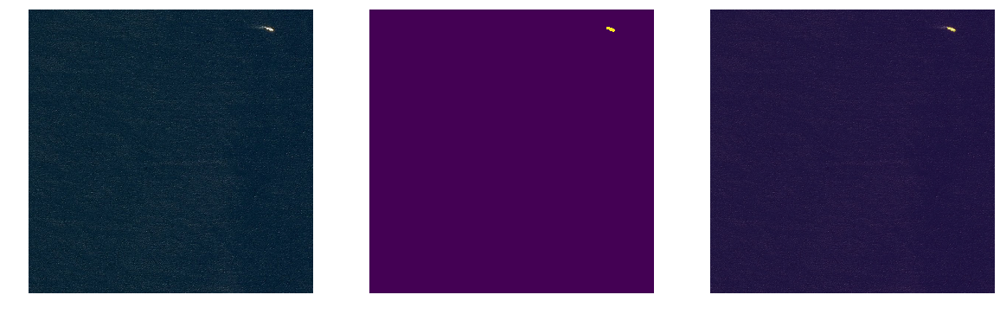

0.6


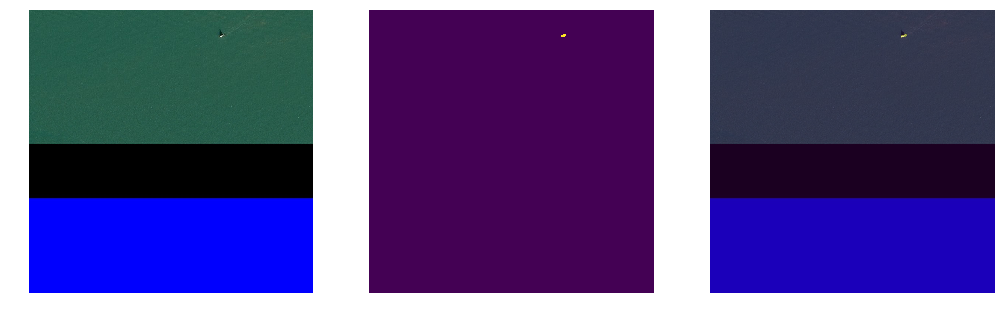

0.6


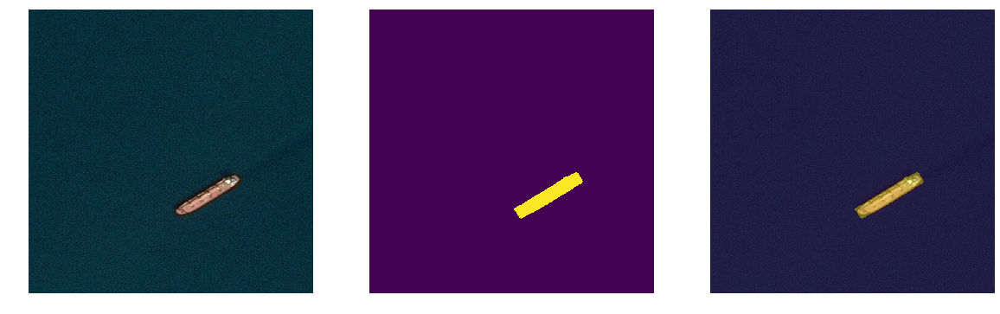

0.2


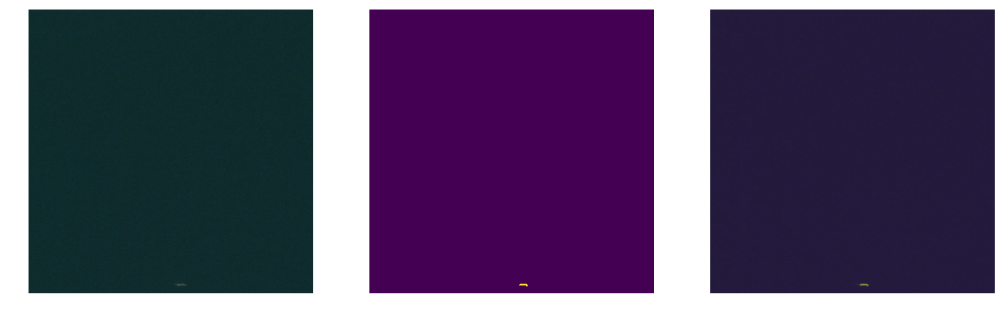

0.0


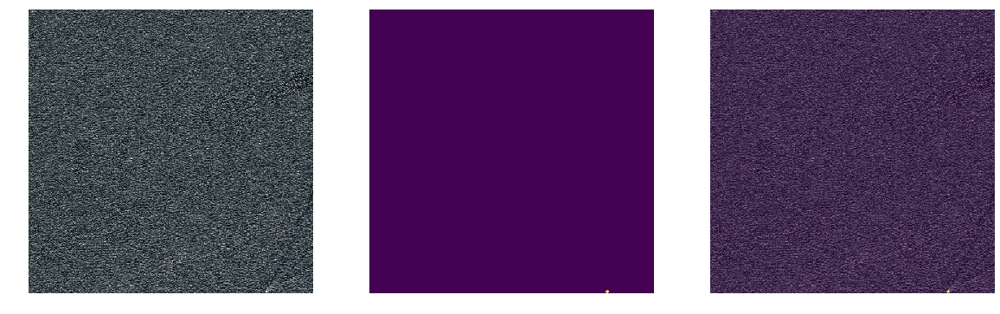

0.41666666666666663


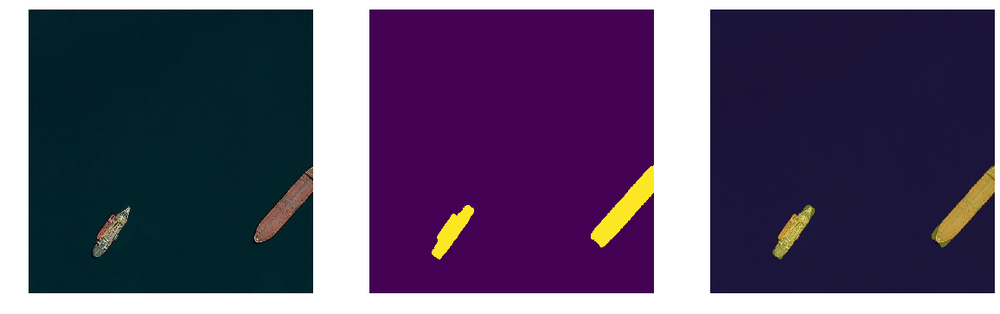

0.3


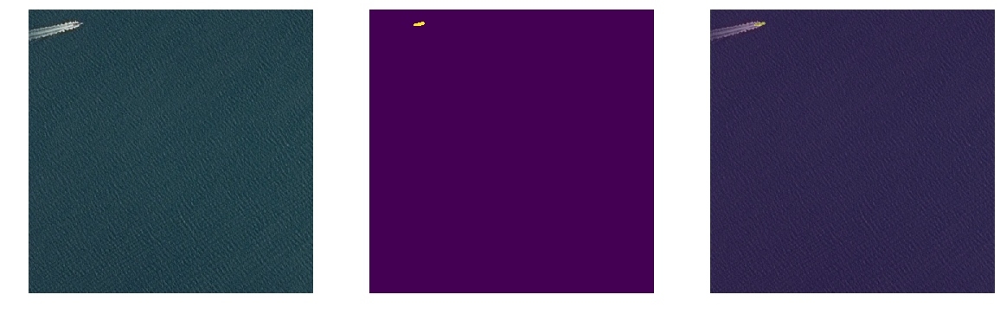

0.42857142857142855


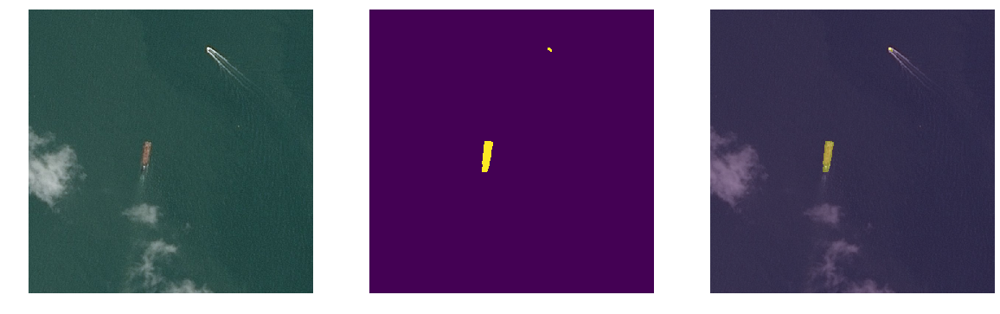

0.2


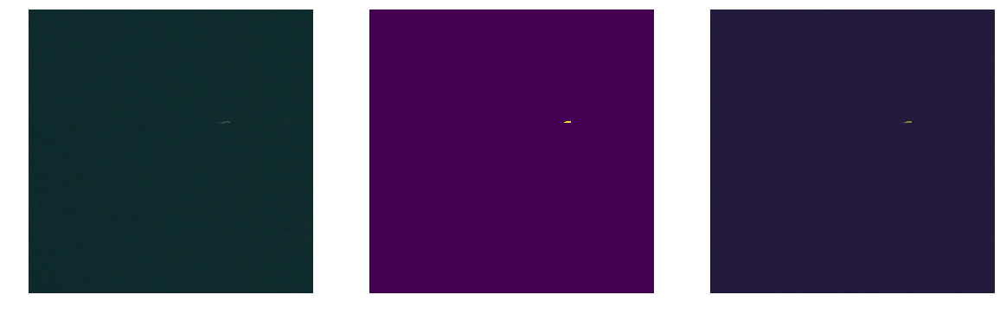

0.5


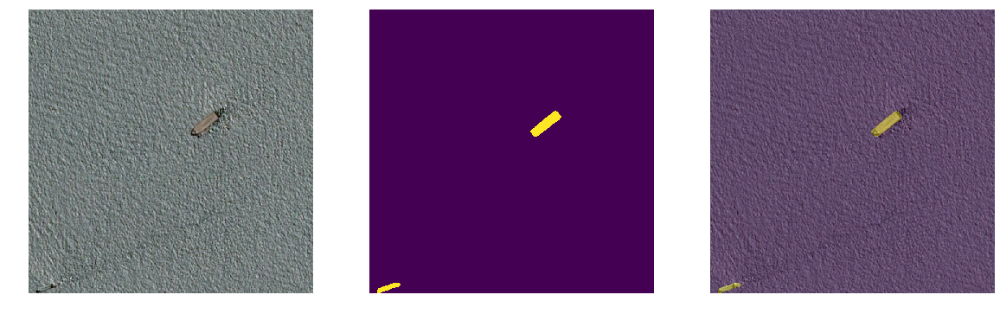

In [311]:
for i, (pred, fname) in enumerate(pred_fnames):
    fname = fname.split("/")[1]    
    gt_rles = test_seg_lbs[test_seg_lbs.ImageId == fname]['EncodedPixels'].values
    f2_score = single_image_score(label(pred>0.5), gt_rles, gt_rles)
    print(f2_score)
    show_img_masks(open_image(path/f"test/{fname}"), pred>0.5, size=(20, 20))
    plt.show()
    if i == 10: break

In [312]:
score_maps = []
for pred, fname in zip(test_preds, learn.data.test_ds.fnames):
    fname = fname.split("/")[1]    
    gt_rles = test_seg_lbs[test_seg_lbs.ImageId == fname]['EncodedPixels'].values
    f2_score = single_image_score(label(pred>0.5), gt_rles, gt_rles)
    score_maps.append((len(gt_rles), f2_score))

In [313]:
test_eval_df = pd.DataFrame(score_maps, columns=["n_ships", "f2score"])
test_eval_df.groupby("n_ships")["f2score"].mean()

n_ships
1     0.494303
2     0.416219
3     0.376205
4     0.353562
5     0.295677
6     0.293377
7     0.316539
8     0.283270
9     0.291005
10    0.265865
11    0.338660
12    0.154248
13    0.223036
14    0.254344
15    0.131042
Name: f2score, dtype: float64

In [314]:
test_eval_df["f2score"].mean()

0.44998080097305787

In [296]:
test_eval_df = pd.DataFrame(score_maps, columns=["n_ships", "f2score"])
test_eval_df.groupby("n_ships")["f2score"].mean()

n_ships
1     0.495481
2     0.416973
3     0.376803
4     0.356717
5     0.296013
6     0.295688
7     0.316453
8     0.280145
9     0.290012
10    0.264620
11    0.337137
12    0.150426
13    0.223043
14    0.252711
15    0.140326
Name: f2score, dtype: float64

In [297]:
test_eval_df["f2score"].mean()

0.4510420087019851

### Segmentation submission

In [315]:
from rle import rle_encode, rle_decode

In [317]:
classification_preds_rob = pd.read_csv(path/"team_data/classifier_tst_ensemble_binpred5_50.csv")

In [318]:
classification_preds = pd.read_csv(path/"classification/test_preds_resnet34_classification_ft_v2_224.csv", usecols=[1,2])

In [319]:
has_ship_images = classification_preds_rob[(classification_preds_rob.EncodedPixels.isnull())]['ImageId'].values

In [320]:
classification_preds_rob.head()

,ImageId,EncodedPixels
0,00002bd58.jpg,1 2
1,00015efb6.jpg,1 2
2,00023d5fc.jpg,1 2
3,000367c13.jpg,NaN
4,0008ca6e9.jpg,1 2


In [321]:
# thresh = 0.5
# sum(classification_preds.has_ship_proba > thresh)

In [322]:
#has_ship_images = classification_preds[classification_preds.has_ship_proba > thresh]["ImageId"].values

In [323]:
test_seg_fnames = [f"test_v2/{fname}" for fname in has_ship_images]

In [324]:
TEST_SUB_X = test_seg_fnames
TEST_SUB_Y = TRN_Y[:len(test_seg_fnames)]

In [325]:
len(TEST_SUB_X)

2990

In [326]:
#RandomRotate(deg=30, p=0.7, tfm_y=TfmType.PIXEL)
f = resnet18
sz = 768
tfms = tfms_from_model(f,
                       sz,
                       aug_tfms=[RandomDihedral(tfm_y=TfmType.PIXEL),
                                 RandomBlur(),
                                 RandomLighting(0.05, 0.05)],
                       tfm_y=TfmType.PIXEL,
                       norm_y=False,
                       crop_type=CropType.NO) 

In [327]:
dataset = ImageData.get_ds(FilesEncodedDataset, 
                           trn=(TRN_X, TRN_Y),
                           val=(VAL_X, VAL_Y), tfms=tfms,
                           test=(TEST_SUB_X, TEST_SUB_Y) ,path=path)

In [328]:
md = ImageData(path, dataset, bs=4, num_workers=8, classes=None)

In [329]:
f = resnet18
cut, cut_lr = model_meta[f]
model = get_model(f, sz=768)
models = UpsampleModel(model, cut_lr)

learn = ConvLearner(md, models)
learn.opt_fn=optim.Adam
learn.crit = MixedLoss(10, 2)
learn.metrics = [fastai_metric]

In [330]:
learn.load("team_resnet18_fold_2")

In [331]:
model = learn.model.eval()

In [332]:
test_tta_preds = []
for i, (x,y) in enumerate(learn.data.test_dl):
    if i % 100 == 0: print(i)
    test_tta_preds += tta_preds(x, model, mode="mean")

0
100
200
300
400
500
600
700


In [333]:
test_preds = test_tta_preds
test_fnames = [fname.split("/")[1] for fname in learn.data.test_ds.fnames]

In [334]:
len(test_preds), len(test_fnames)

(2990, 2990)

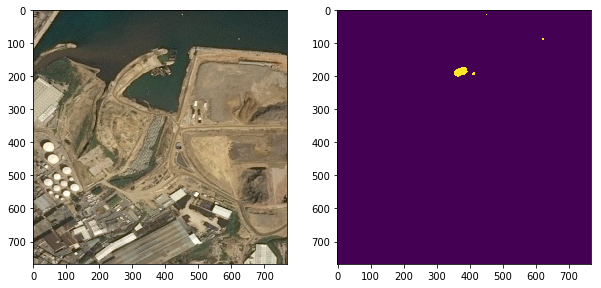

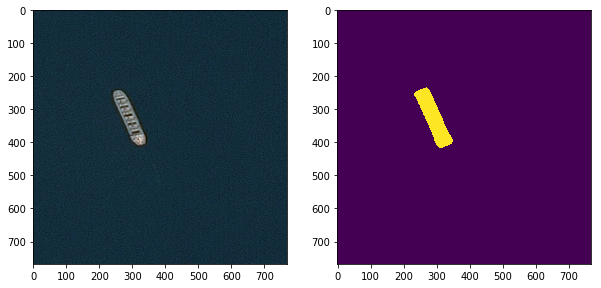

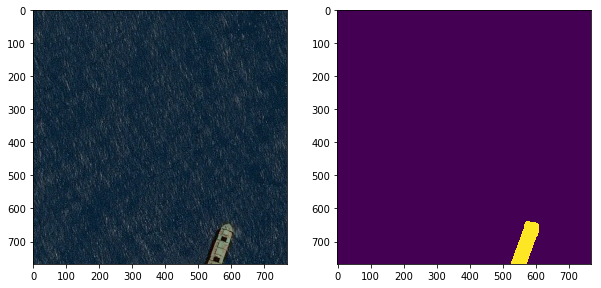

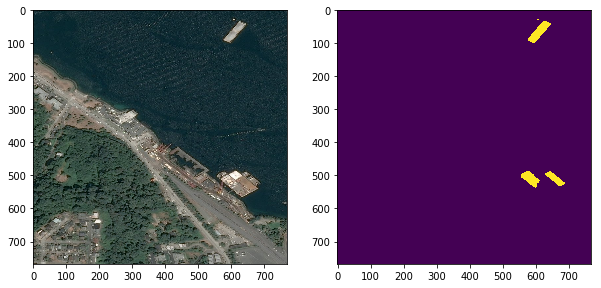

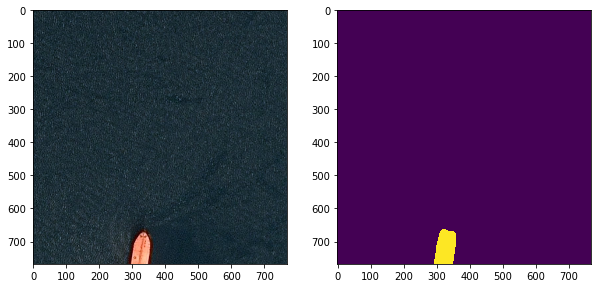

In [335]:
for i in range(5):
    fig, axes = plt.subplots(1,2, figsize=(10,10))
    axes[0].imshow(open_image(path/f"test_v2/{test_fnames[i]}"))
    axes[1].imshow(test_preds[i] > 0.5)

In [336]:
long_preds = []
for fname, pred in zip(test_fnames, test_preds):
    labels = label(pred > 0.5)
    pred_masks = get_pred_masks(labels, sz=None, mask2rect=False, remove_sub_px=20)
    if pred_masks == []:
        long_preds.append((fname, None))
    else:
        for pred_mask in pred_masks:
            long_preds.append((fname, rle_encode(pred_mask)))

In [337]:
segmentation_preds = pd.DataFrame(list(zip(*long_preds))).T.rename(columns={0:"ImageId", 1:"EncodedPixels"})

In [338]:
segmentation_preds.ImageId.nunique()

2990

In [339]:
segmentation_preds.head(2)

,ImageId,EncodedPixels
0,000367c13.jpg,476247 4 477014 5 477782 6 478550 6 479318 5 4...
1,000367c13.jpg,271293 1 272057 10 272824 13 273591 16 274358 ...


In [340]:
#no_ship_img_ids = classification_preds[classification_preds.has_ship_proba <= thresh]["ImageId"].values

In [341]:
no_ship_img_ids = classification_preds_rob[~classification_preds_rob.EncodedPixels.isnull()]["ImageId"]

In [342]:
len(no_ship_img_ids)

12616

In [343]:
no_ship_df = pd.DataFrame({"ImageId": no_ship_img_ids, "EncodedPixels":None})

In [344]:
no_ship_df.head(2)

,ImageId,EncodedPixels
0,00002bd58.jpg,None
1,00015efb6.jpg,None


In [345]:
submission_df = pd.concat([no_ship_df, segmentation_preds])

In [346]:
submission_df.ImageId.nunique()

15606

In [347]:
submission_df.head(2)

,ImageId,EncodedPixels
0,00002bd58.jpg,None
1,00015efb6.jpg,None


In [348]:
submission_df.shape

(17434, 2)

In [349]:
path

PosixPath('../DATA/airbus-ship')

In [350]:
submission_df.to_csv(path/"submission/rob_cls_resnet_18_fold2_TTA8_sub20.csv", index=False)

In [351]:
FileLink(path/"submission/rob_cls_resnet_18_fold2_TTA8_sub20.csv")

/home/ubuntu/DATA/airbus-ship/submission/rob_cls_resnet_18_fold2_TTA8_sub20.csv

### Visualize Test Preds

In [352]:
from seg_plots import plot_segmentation_df

In [353]:
segmentation_ship_preds = segmentation_preds[~segmentation_preds['EncodedPixels'].isnull()]

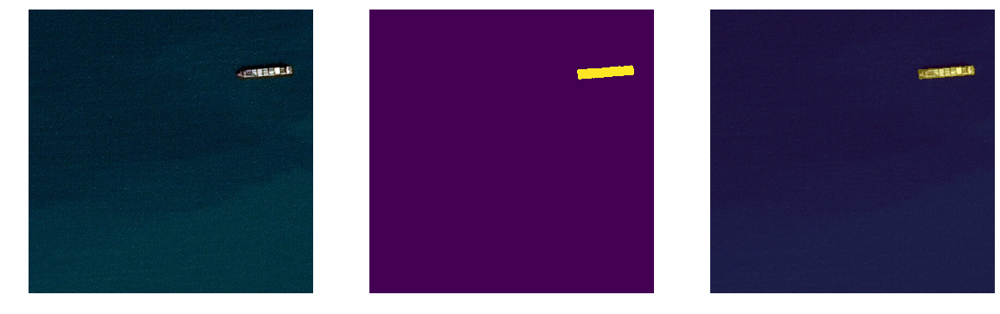

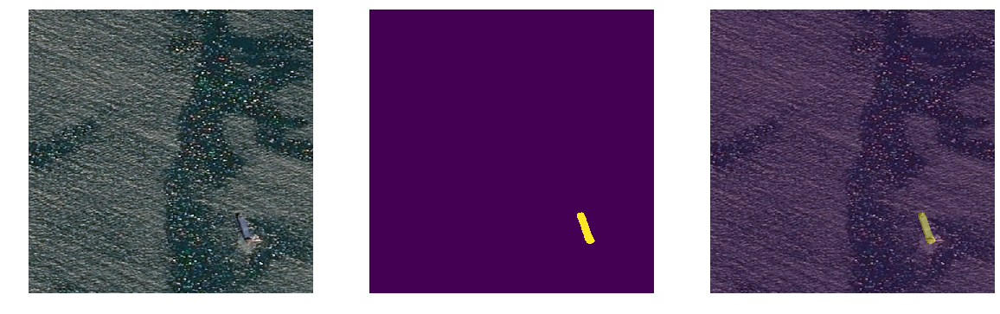

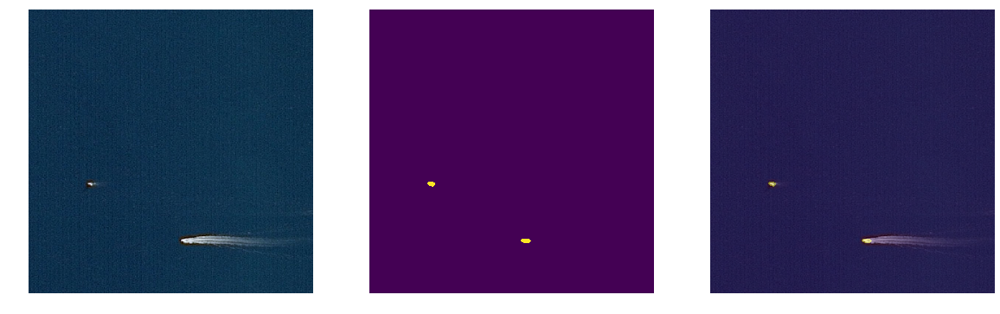

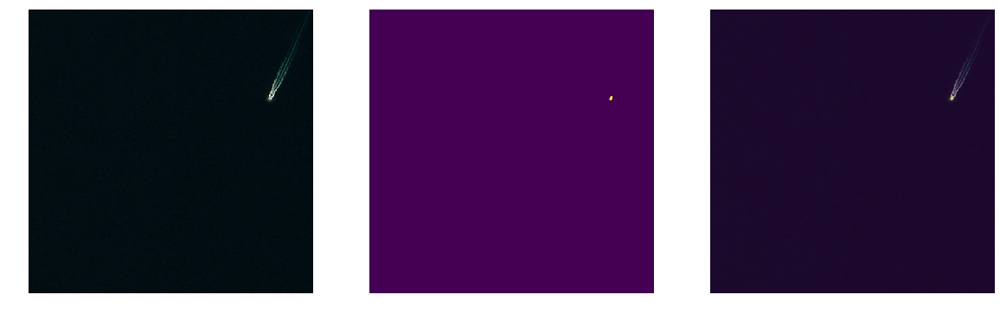

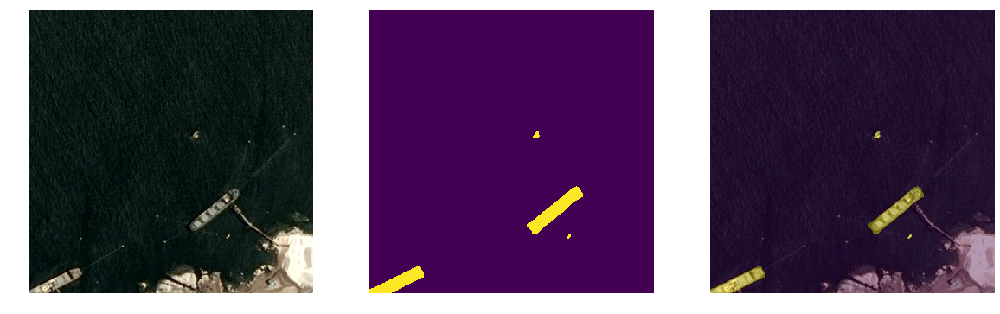

...

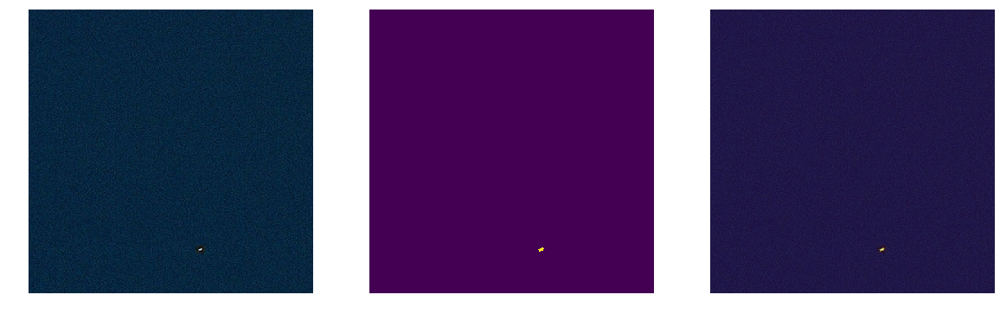

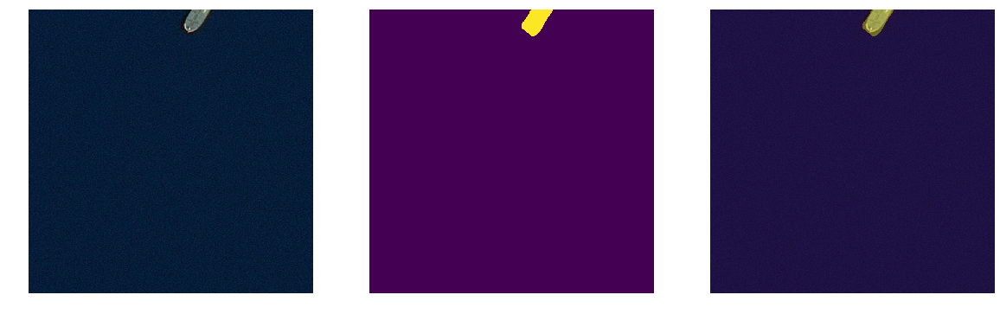

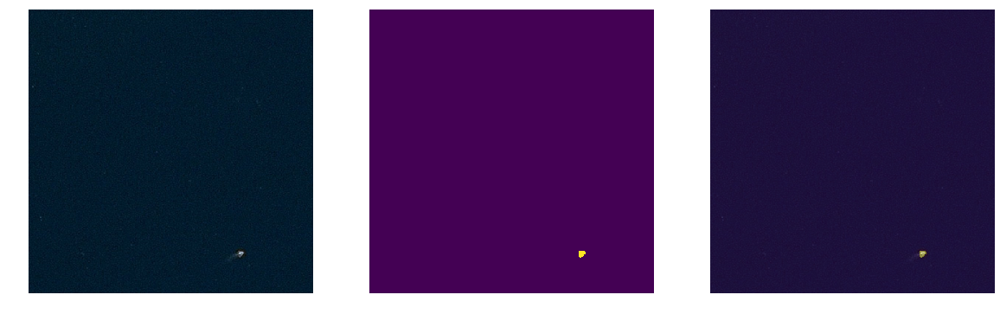

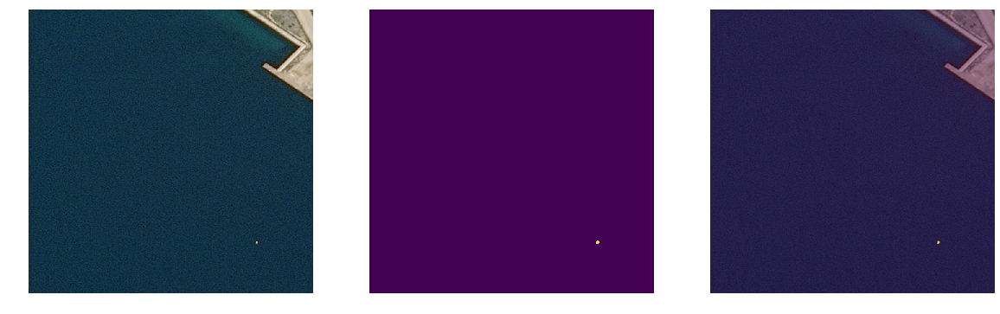

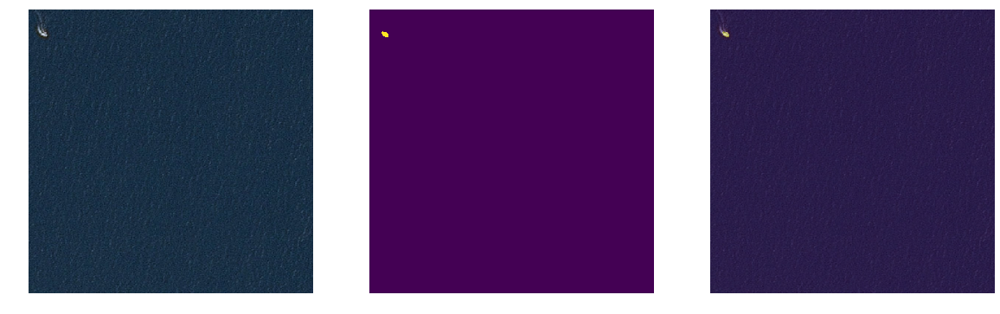

In [355]:
plot_segmentation_df(segmentation_ship_preds, path/"test_v2", n=30)